# BREAST CANCER PREDICTION

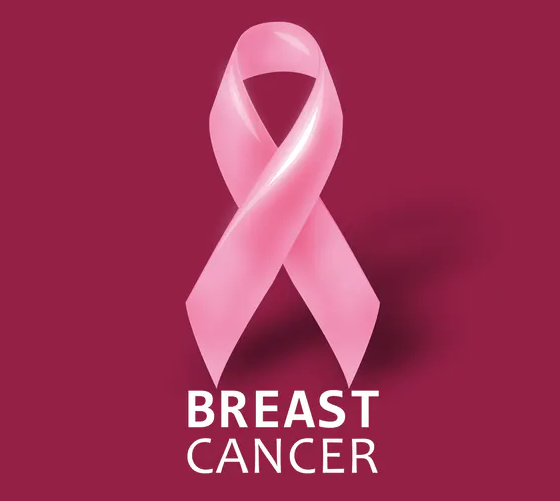

In [ ]:
#importing the essental libraries 

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')
plt.figure(figsize=(5,5))
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split
from datetime import datetime as dt
from datetime import datetime, timedelta

#-----------------------------------------------------
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
#----------------------------------------------------

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
#----------------------------------------------------

import keras 
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
#----------------------------------------------------

<Figure size 360x360 with 0 Axes>

In [4]:
from sklearn.datasets import load_breast_cancer

In [5]:
#loading the Breast cancer data in a variable
cancer = load_breast_cancer()

In [6]:
cancer
#printing the Data in Dictionary format

{'data': array([[1.799e+01, 1.038e+01, 1.228e+02, ..., 2.654e-01, 4.601e-01,
         1.189e-01],
        [2.057e+01, 1.777e+01, 1.329e+02, ..., 1.860e-01, 2.750e-01,
         8.902e-02],
        [1.969e+01, 2.125e+01, 1.300e+02, ..., 2.430e-01, 3.613e-01,
         8.758e-02],
        ...,
        [1.660e+01, 2.808e+01, 1.083e+02, ..., 1.418e-01, 2.218e-01,
         7.820e-02],
        [2.060e+01, 2.933e+01, 1.401e+02, ..., 2.650e-01, 4.087e-01,
         1.240e-01],
        [7.760e+00, 2.454e+01, 4.792e+01, ..., 0.000e+00, 2.871e-01,
         7.039e-02]]),
 'target': array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0,
        1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0,
        1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
        1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0

In [7]:
cancer.keys()
#Printing the keys of the Dictionary, to get enough details about the data.

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])

In [8]:
cancer.values()

dict_values([array([[1.799e+01, 1.038e+01, 1.228e+02, ..., 2.654e-01, 4.601e-01,
        1.189e-01],
       [2.057e+01, 1.777e+01, 1.329e+02, ..., 1.860e-01, 2.750e-01,
        8.902e-02],
       [1.969e+01, 2.125e+01, 1.300e+02, ..., 2.430e-01, 3.613e-01,
        8.758e-02],
       ...,
       [1.660e+01, 2.808e+01, 1.083e+02, ..., 1.418e-01, 2.218e-01,
        7.820e-02],
       [2.060e+01, 2.933e+01, 1.401e+02, ..., 2.650e-01, 4.087e-01,
        1.240e-01],
       [7.760e+00, 2.454e+01, 4.792e+01, ..., 0.000e+00, 2.871e-01,
        7.039e-02]]), array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0,
       1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0,
       

In [9]:
print(cancer['DESCR'])
#Will basically gve you broad description of Breast Cancer Dataset

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on the perimeter)
        - texture (standard deviation of gray-scale values)
        - perimeter
        - area
        - smoothness (local variation in radius lengths)
        - compactness (perimeter^2 / area - 1.0)
        - concavity (severity of concave portions of the contour)
        - concave points (number of concave portions of the contour)
        - symmetry
        - fractal dimension ("coastline approximation" - 1)

        The mean, standard error, and "worst" or largest (mean of the three
        worst/largest values) of these features were computed for each image,
        resulting in 30 features.  For instance, field 0 is Mean Radi

In [10]:
print(cancer['target'])
#Printing the Target column, which is either 0=Malignenet or 1=Benign

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0
 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1
 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 1 0
 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1
 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1
 1 1 0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0
 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 0 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 1 0 1 1 1 1 1 0 1 1
 0 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 0 1
 1 1 1 1 1 1 0 1 0 1 1 0 

In [11]:
print(cancer['target_names'])
#printing the Target names

['malignant' 'benign']


In [12]:
print(cancer['feature_names'])

#All the column names which are also known as features

['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


In [13]:
cancer['data'].shape

#Shape of the Data which is 569 Rows and 30 Columns

(569, 30)

In [14]:
df_cancer = pd.DataFrame(np.c_[cancer['data'], cancer['target']], columns= np.append(cancer['feature_names'],['target']))

#Creating a Pandas DataFrame to deal with the data in a much easier way.
#While creating this DataFrame we added the additional column which is 'target' to the df_cancer using np.append().

In [153]:
df_cancer.head()
#to print the first 5 rows of the data, also lookaround for the target column which I've added. 

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0.0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0.0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0.0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0.0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0.0


In [154]:
# Here we are using inbuilt dataset of scikit learn
from sklearn.datasets import load_breast_cancer

# instantiating
cancer = load_breast_cancer()

# creating dataframe
df = pd.DataFrame(cancer['data'], columns = cancer['feature_names'])

# checking head of dataframe
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [155]:
# Importing standardscalar module
from sklearn.preprocessing import StandardScaler

scalar = StandardScaler()

# fitting
scalar.fit(df)
scaled_data = scalar.transform(df)

# Importing PCA
from sklearn.decomposition import PCA

# Let's say, components = 2
pca = PCA(n_components = 2)
pca.fit(scaled_data)
x_pca = pca.transform(scaled_data)

x_pca.shape

(569, 2)

Text(0, 0.5, 'Second Principal Component')

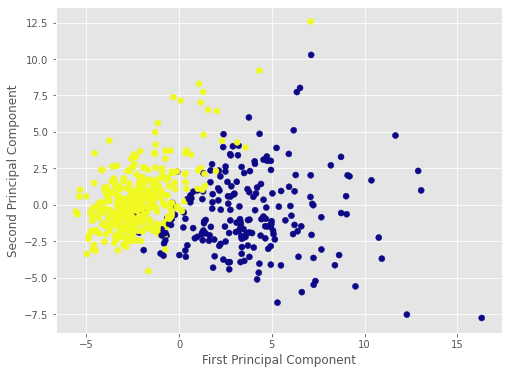

In [156]:
# giving a larger plot
plt.figure(figsize =(8, 6))

plt.scatter(x_pca[:, 0], x_pca[:, 1], c = cancer['target'], cmap ='plasma')

# labeling x and y axes
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')

In [157]:
# components
pca.components_

array([[ 0.21890244,  0.10372458,  0.22753729,  0.22099499,  0.14258969,
         0.23928535,  0.25840048,  0.26085376,  0.13816696,  0.06436335,
         0.20597878,  0.01742803,  0.21132592,  0.20286964,  0.01453145,
         0.17039345,  0.15358979,  0.1834174 ,  0.04249842,  0.10256832,
         0.22799663,  0.10446933,  0.23663968,  0.22487053,  0.12795256,
         0.21009588,  0.22876753,  0.25088597,  0.12290456,  0.13178394],
       [-0.23385713, -0.05970609, -0.21518136, -0.23107671,  0.18611302,
         0.15189161,  0.06016536, -0.0347675 ,  0.19034877,  0.36657547,
        -0.10555215,  0.08997968, -0.08945723, -0.15229263,  0.20443045,
         0.2327159 ,  0.19720728,  0.13032156,  0.183848  ,  0.28009203,
        -0.21986638, -0.0454673 , -0.19987843, -0.21935186,  0.17230435,
         0.14359317,  0.09796411, -0.00825724,  0.14188335,  0.27533947]])

<AxesSubplot:>

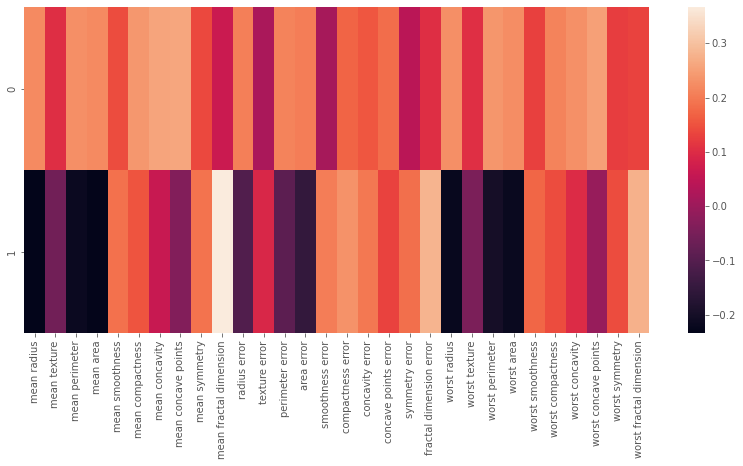

In [158]:
df_comp = pd.DataFrame(pca.components_, columns = cancer['feature_names'])

plt.figure(figsize =(14, 6))

# plotting heatmap
sns.heatmap(df_comp)

# VISUALISING THE DATA

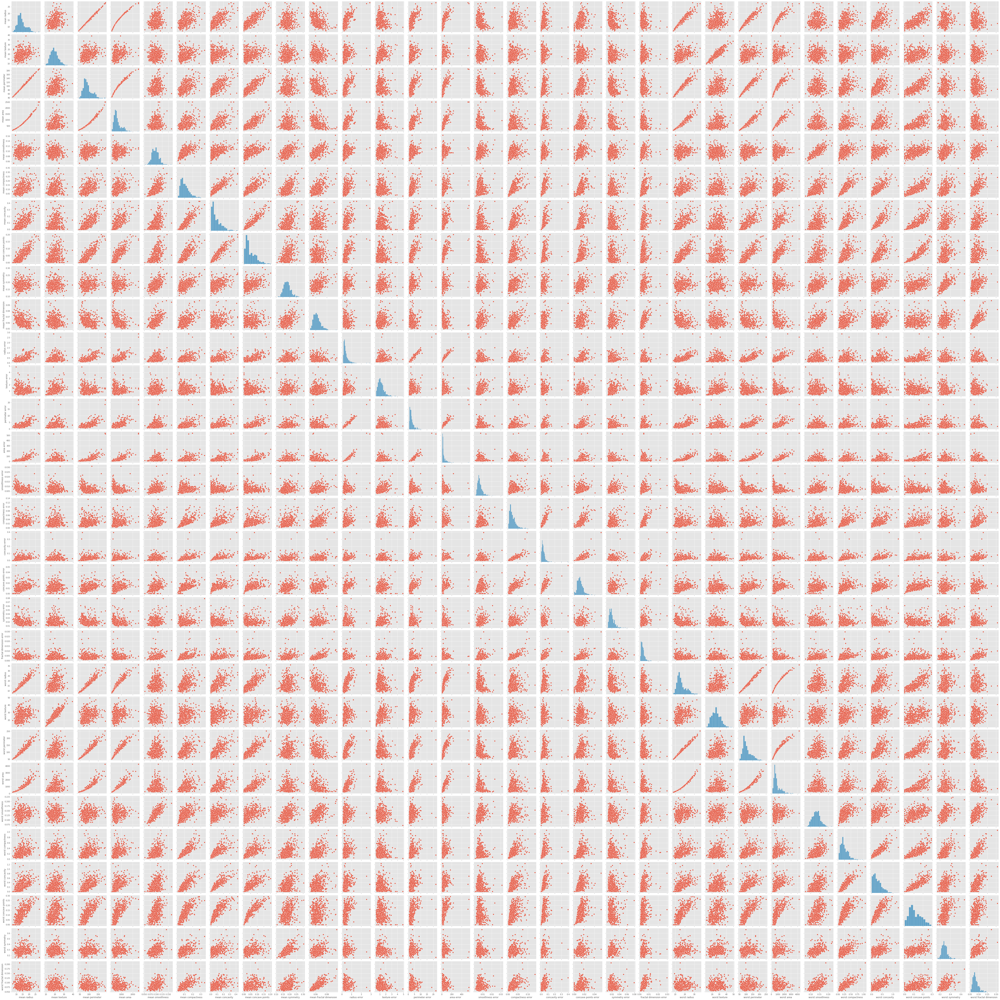

In [16]:
sns.pairplot(df_cancer , vars =['mean radius','mean texture', 'mean perimeter', 'mean area',
 'mean smoothness', 'mean compactness' ,'mean concavity',
 'mean concave points', 'mean symmetry', 'mean fractal dimension',
 'radius error', 'texture error', 'perimeter error', 'area error',
 'smoothness error', 'compactness error', 'concavity error',
 'concave points error', 'symmetry error', 'fractal dimension error',
 'worst radius', 'worst texture', 'worst perimeter', 'worst area',
 'worst smoothness', 'worst compactness', 'worst concavity',
 'worst concave points', 'worst symmetry', 'worst fractal dimension'])                                                                                                                                                                          

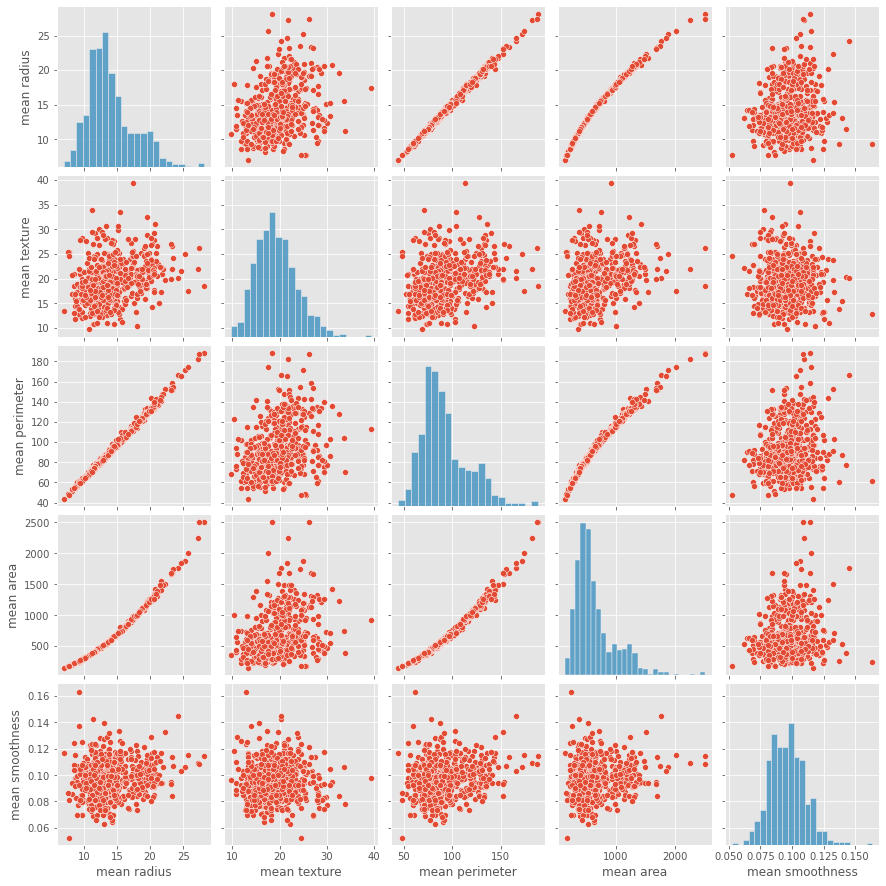

In [17]:
#taking only 5 variable out of 30 just to showcase how powerfull seaborn library actually is
sns.pairplot(df_cancer, vars = ['mean radius', 'mean texture', 'mean perimeter', 'mean area',
 'mean smoothness'])

<Figure size 800x640 with 0 Axes>

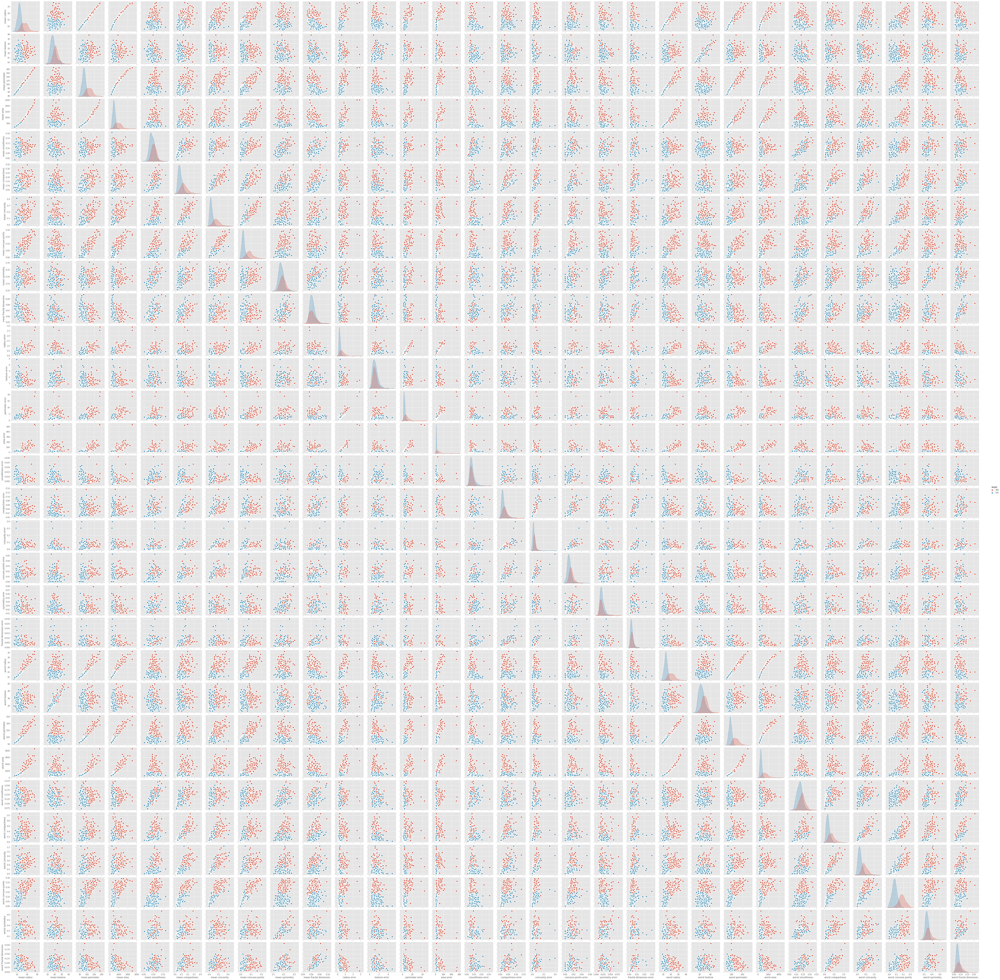

In [18]:
plt.figure(figsize=(10,8), dpi= 80)
sns.pairplot(df_cancer, kind="scatter", hue="target", plot_kws=dict(s=80, edgecolor="white", linewidth=2.5))
plt.show()

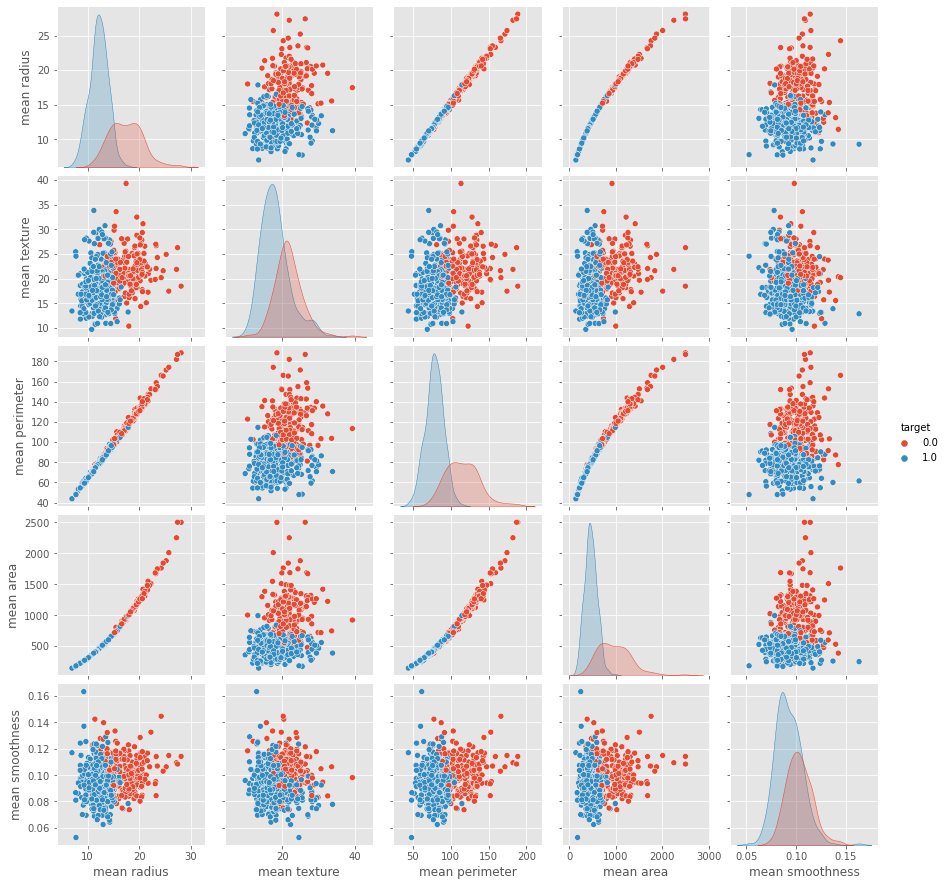

In [19]:
#in above plotting we are not able to differentiate much,so we use 'hue' on target column, which will seperate the two(Malignent, Benign).
sns.pairplot(df_cancer, hue = 'target', vars = ['mean radius', 'mean texture', 'mean perimeter', 'mean area',
 'mean smoothness'])

#blue points are malignent case which are severe cases or life threatning cases.
#orange points are not very severe or life threatning

<AxesSubplot:xlabel='target', ylabel='count'>

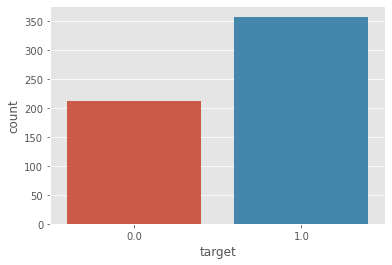

In [20]:
#will simply tell you how many Malignent and Benign cases we have.
#Malignent= 200~ and Benign = 350~ approx.
sns.countplot(df_cancer['target'])

<AxesSubplot:xlabel='mean area', ylabel='mean smoothness'>

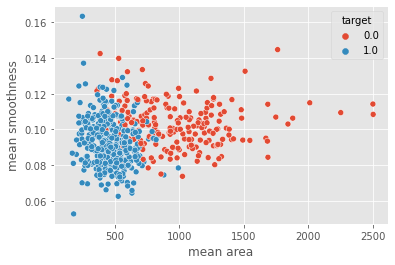

In [21]:
#plotting a scatter plot diagram for mean area anf mean smoothness, you can plot any feature combination scatterplot.
sns.scatterplot(x='mean area',y='mean smoothness',hue='target',data =df_cancer)

<AxesSubplot:>

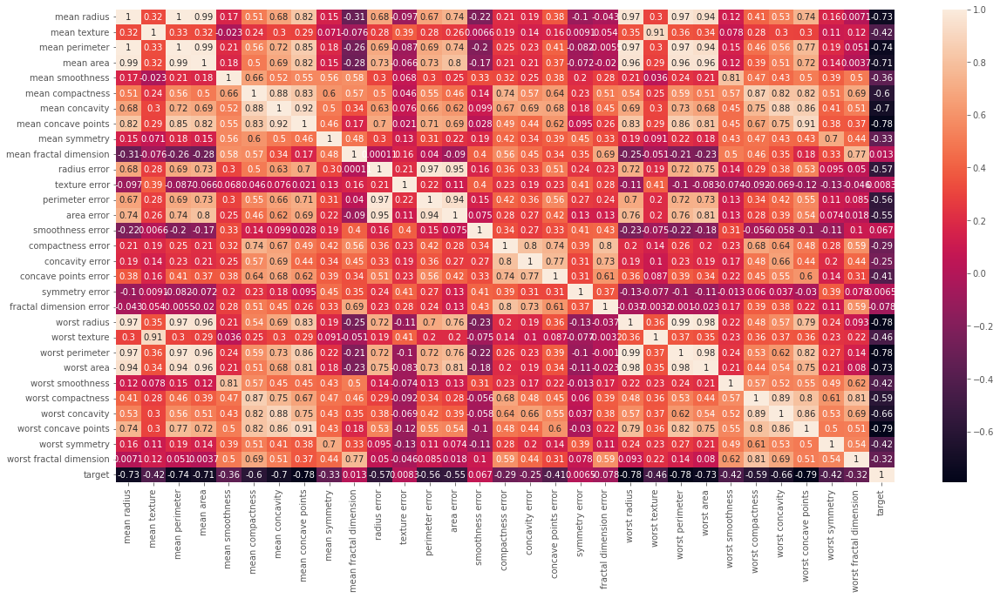

In [22]:
#here we made a heatmap figure of correlation of all the columns
plt.figure(figsize =(20,10))
sns.heatmap(df_cancer.corr(), annot =True)

# SPLITTING THE DATASET

In [295]:
x = df_cancer.drop(['target'],axis =1)
#train test split

In [296]:
x

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [297]:
y= df_cancer['target']

In [298]:
y

0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
564    0.0
565    0.0
566    0.0
567    0.0
568    1.0
Name: target, Length: 569, dtype: float64

In [299]:
#'test_size' is what is the size of the test data whicg is 15% of the whole data. we had 569 rows which will get split by train = 483 and test = 86. 
#look below for better understanding, we've printed all the 4 values for X_train, X_text, y_train, y_test.
#also make sure the X is capital and y is small..
from sklearn.model_selection import train_test_split

In [300]:
 x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=5)

In [301]:
 x_train

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
306,13.200,15.82,84.07,537.3,0.08511,0.05251,0.001461,0.003261,0.1632,0.05894,...,14.41,20.45,92.00,636.9,0.11280,0.1346,0.01120,0.02500,0.2651,0.08385
410,11.360,17.57,72.49,399.8,0.08858,0.05313,0.027830,0.021000,0.1601,0.05913,...,13.05,36.32,85.07,521.3,0.14530,0.1622,0.18110,0.08698,0.2973,0.07745
197,18.080,21.84,117.40,1024.0,0.07371,0.08642,0.110300,0.057780,0.1770,0.05340,...,19.76,24.70,129.10,1228.0,0.08822,0.1963,0.25350,0.09181,0.2369,0.06558
376,10.570,20.22,70.15,338.3,0.09073,0.16600,0.228000,0.059410,0.2188,0.08450,...,10.85,22.82,76.51,351.9,0.11430,0.3619,0.60300,0.14650,0.2597,0.12000
244,19.400,23.50,129.10,1155.0,0.10270,0.15580,0.204900,0.088860,0.1978,0.06000,...,21.65,30.53,144.90,1417.0,0.14630,0.2968,0.34580,0.15640,0.2920,0.07614
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8,13.000,21.82,87.50,519.8,0.12730,0.19320,0.185900,0.093530,0.2350,0.07389,...,15.49,30.73,106.20,739.3,0.17030,0.5401,0.53900,0.20600,0.4378,0.10720
73,13.800,15.79,90.43,584.1,0.10070,0.12800,0.077890,0.050690,0.1662,0.06566,...,16.57,20.86,110.30,812.4,0.14110,0.3542,0.27790,0.13830,0.2589,0.10300
400,17.910,21.02,124.40,994.0,0.12300,0.25760,0.318900,0.119800,0.2113,0.07115,...,20.80,27.78,149.60,1304.0,0.18730,0.5917,0.90340,0.19640,0.3245,0.11980
118,15.780,22.91,105.70,782.6,0.11550,0.17520,0.213300,0.094790,0.2096,0.07331,...,20.19,30.50,130.30,1272.0,0.18550,0.4925,0.73560,0.20340,0.3274,0.12520


In [302]:
 y_train

306    1.0
410    1.0
197    0.0
376    1.0
244    0.0
      ... 
8      0.0
73     0.0
400    0.0
118    0.0
206    1.0
Name: target, Length: 455, dtype: float64

In [303]:
 x_test

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
28,15.30,25.27,102.40,732.4,0.10820,0.16970,0.16830,0.08751,0.1926,0.06540,...,20.27,36.71,149.30,1269.0,0.1641,0.61100,0.63350,0.20240,0.4027,0.09876
163,12.34,22.22,79.85,464.5,0.10120,0.10150,0.05370,0.02822,0.1551,0.06761,...,13.58,28.68,87.36,553.0,0.1452,0.23380,0.16880,0.08194,0.2268,0.09082
123,14.50,10.89,94.28,640.7,0.11010,0.10990,0.08842,0.05778,0.1856,0.06402,...,15.70,15.98,102.80,745.5,0.1313,0.17880,0.25600,0.12210,0.2889,0.08006
361,13.30,21.57,85.24,546.1,0.08582,0.06373,0.03344,0.02424,0.1815,0.05696,...,14.20,29.20,92.94,621.2,0.1140,0.16670,0.12120,0.05614,0.2637,0.06658
549,10.82,24.21,68.89,361.6,0.08192,0.06602,0.01548,0.00816,0.1976,0.06328,...,13.03,31.45,83.90,505.6,0.1204,0.16330,0.06194,0.03264,0.3059,0.07626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
414,15.13,29.81,96.71,719.5,0.08320,0.04605,0.04686,0.02739,0.1852,0.05294,...,17.26,36.91,110.10,931.4,0.1148,0.09866,0.15470,0.06575,0.3233,0.06165
515,11.34,18.61,72.76,391.2,0.10490,0.08499,0.04302,0.02594,0.1927,0.06211,...,12.47,23.03,79.15,478.6,0.1483,0.15740,0.16240,0.08542,0.3060,0.06783
186,18.31,18.58,118.60,1041.0,0.08588,0.08468,0.08169,0.05814,0.1621,0.05425,...,21.31,26.36,139.20,1410.0,0.1234,0.24450,0.35380,0.15710,0.3206,0.06938
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.86630,0.68690,0.25750,0.6638,0.17300


In [304]:
 y_test

28     0.0
163    1.0
123    1.0
361    1.0
549    1.0
      ... 
414    0.0
515    1.0
186    0.0
3      0.0
261    0.0
Name: target, Length: 114, dtype: float64

# TRAINING THE MODEL USING LOGISTIC REGRESSION

In [305]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report , confusion_matrix

In [306]:
logistic_model = LogisticRegression(random_state = 0)
logistic_model.fit(x_train, y_train)

LogisticRegression(random_state=0)

In [307]:
y_predict =logistic_model.predict(x_test)
y_predict

array([0., 1., 1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 1., 0., 0., 0., 0., 0.,
       1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 1., 0., 1.,
       1., 1., 1., 1., 0., 0., 0., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 0., 1., 0., 1., 1., 1., 1., 0., 1., 0., 1., 0., 1., 0., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 0.,
       1., 1., 0., 0., 1., 0., 1., 0., 1., 0., 1., 0.])

In [308]:
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

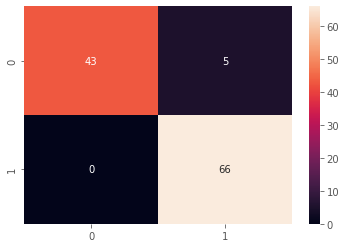

In [309]:
sns.heatmap(cm ,annot=True)

# MODEL IMPROVISATION

In [310]:
logistic_model.fit(x_train,y_train)

LogisticRegression(random_state=0)

In [311]:
y_predict =logistic_model.predict(x_test)

In [312]:
cn = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

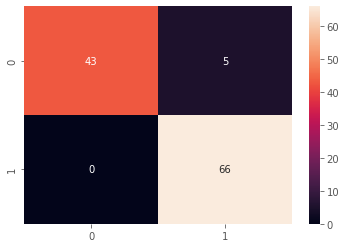

In [313]:
sns.heatmap(cn,  annot = True)

In [314]:
st=dt.now()
logits = LogisticRegression(solver = 'liblinear')
logits.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

pred_logits = logits.predict(x_test)

#Model Evaluation
logits_acc = accuracy_score(y_test, y_predict)
print('Accuracy Score: ' + str(logits_acc))

print('Precision Score: ' + str(precision_score(y_test, y_predict)))

print('Recall Score: ' + str(recall_score(y_test, y_predict)))

print('F1 Score: ' + str(f1_score(y_test, y_predict)))

print('Classification Report: \n' + str(classification_report(y_test, y_predict)))

Time taken to complete random search:  0:00:00.008016
Accuracy Score: 0.956140350877193
Precision Score: 0.9295774647887324
Recall Score: 1.0
F1 Score: 0.9635036496350364
Classification Report: 
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95        48
         1.0       0.93      1.00      0.96        66

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114



# USING KNEIGHBORSCLASSIFIER METHOD OF NEIGHBORS CLASS TO USE NEAREST NEIGHBOR ALGORITHM

In [315]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report , confusion_matrix

In [316]:
knn_model = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
knn_model.fit(x_train, y_train)

KNeighborsClassifier()

In [317]:
y_predict =knn_model.predict(x_test)
y_predict

array([0., 1., 1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 1., 0., 0., 0., 1., 0.,
       1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 1., 0., 1.,
       1., 1., 1., 1., 0., 1., 0., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 0., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 0., 1., 0., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 0.,
       1., 1., 0., 0., 1., 0., 1., 0., 1., 0., 1., 0.])

In [318]:
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

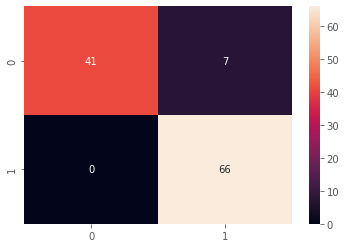

In [319]:
sns.heatmap(cm ,annot=True)

In [324]:
from sklearn import metrics
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(x_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))

Train set Accuracy:  0.9384615384615385
Test set Accuracy:  0.9385964912280702


In [325]:
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92        48
         1.0       0.90      1.00      0.95        66

    accuracy                           0.94       114
   macro avg       0.95      0.93      0.94       114
weighted avg       0.94      0.94      0.94       114



# Trying for a random k value for example 5

In [326]:
k = 5

neigh6 = KNeighborsClassifier(n_neighbors = k).fit(x_train,y_train)

yhat6 = neigh6.predict(x_test)

print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh6.predict(x_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat6))

Train set Accuracy:  0.945054945054945
Test set Accuracy:  0.9385964912280702


# Finding the correct value for K

In [327]:
Ks = 10
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(x_train,y_train)
    yhat=neigh.predict(x_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.94736842, 0.93859649, 0.92105263, 0.92105263, 0.93859649,
       0.94736842, 0.92982456, 0.95614035, 0.93859649])

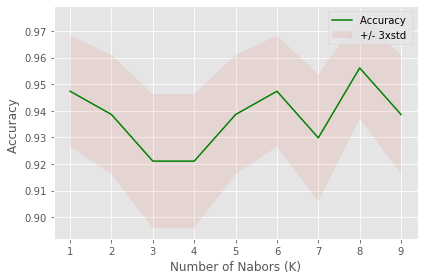

In [328]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

In [329]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

The best accuracy was with 0.956140350877193 with k= 8


# So the best value for k= 8 

In [330]:
k = 8

neigh6 = KNeighborsClassifier(n_neighbors = k).fit(x_train,y_train)

yhat6 = neigh6.predict(x_test)

print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh6.predict(x_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat6))

Train set Accuracy:  0.9318681318681319
Test set Accuracy:  0.956140350877193


#  Now that we have the value of k, we can try to improve the accuracy for our model

In [331]:
knn_model = KNeighborsClassifier(n_neighbors = 8, metric = 'minkowski', p = 2)
knn_model.fit(x_train, y_train)

KNeighborsClassifier(n_neighbors=8)

In [332]:
y_predict =knn_model.predict(x_test)
y_predict

array([0., 1., 1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1., 1.,
       1., 1., 1., 0., 1., 1., 1., 1., 1., 0., 0., 1., 0., 0., 0., 1., 0.,
       1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 1., 0., 1.,
       1., 1., 1., 1., 0., 0., 0., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 0., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 0., 1., 0., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 0.,
       1., 1., 0., 0., 1., 0., 1., 0., 1., 0., 1., 0.])

In [333]:
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

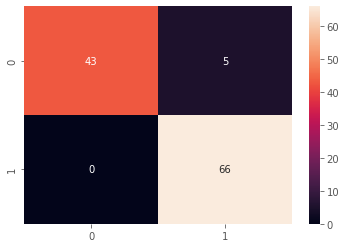

In [334]:
sns.heatmap(cm ,annot=True)

In [335]:
from sklearn import metrics
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(x_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))

Train set Accuracy:  0.9384615384615385
Test set Accuracy:  0.9385964912280702


In [336]:
print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95        48
         1.0       0.93      1.00      0.96        66

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114



In [337]:
st=dt.now()
knn = KNeighborsClassifier(n_neighbors = 8)
knn.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)


knn_pred = knn.predict(x_test)

#Model Evaluation
kacc = accuracy_score(y_test, knn_pred)
print('Accuracy Score: ' + str(kacc))

print('Precision Score: ' + str(precision_score(y_test, knn_pred)))

print('Recall Score: ' + str(recall_score(y_test, knn_pred)))

print('F1 Score: ' + str(f1_score(y_test, knn_pred)))

print('Classification Report: \n' + str(classification_report(y_test, knn_pred)))

Time taken to complete random search:  0:00:00
Accuracy Score: 0.956140350877193
Precision Score: 0.9295774647887324
Recall Score: 1.0
F1 Score: 0.9635036496350364
Classification Report: 
              precision    recall  f1-score   support

         0.0       1.00      0.90      0.95        48
         1.0       0.93      1.00      0.96        66

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114



# TRAINING THE MODEL USING SVM

# LINER SUPPORT VECTOR CLASSIFIER

In [338]:
from sklearn.svm import SVC

In [339]:
from sklearn.metrics import classification_report , confusion_matrix

In [340]:
from sklearn.svm import SVC
svm_model = SVC(kernel = 'linear', random_state = 0)
svm_model.fit(x_train, y_train)

SVC(kernel='linear', random_state=0)

# EVALUATING THE MODEL

In [341]:
y_predict =svm_model.predict(x_test)

In [342]:
y_predict

array([0., 1., 1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1., 1.,
       1., 1., 1., 0., 1., 1., 1., 1., 1., 0., 0., 1., 0., 0., 0., 1., 0.,
       1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 1., 0., 0., 1., 0., 1.,
       1., 1., 1., 1., 0., 0., 0., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 0., 1., 0., 1., 1., 1., 1., 0., 1., 0., 0., 0., 1., 0., 0., 0.,
       1., 0., 1., 0., 0., 0., 0., 1., 1., 0., 0., 1., 1., 1., 1., 1., 0.,
       1., 1., 0., 0., 0., 0., 1., 0., 1., 0., 0., 0.])

In [343]:
cm = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

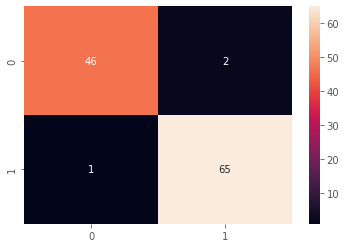

In [344]:
sns.heatmap(cm ,annot=True)

# MODEL IMPROVISATION

In [345]:
min_train =x_train.min()

In [346]:
range_train =(x_train - min_train).max()

In [347]:
x_train_scaled =(x_train-min_train)/range_train

<AxesSubplot:xlabel='mean area', ylabel='mean smoothness'>

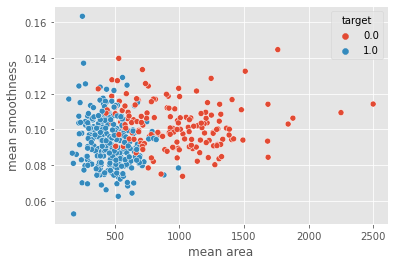

In [348]:
sns.scatterplot(x = x_train['mean area'], y= x_train['mean smoothness'],hue =y_train)

<AxesSubplot:xlabel='mean area', ylabel='mean smoothness'>

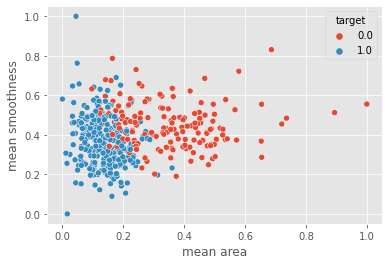

In [349]:
sns.scatterplot(x = x_train_scaled['mean area'], y= x_train_scaled['mean smoothness'],hue =y_train)

In [350]:
min_test =x_test.min()
range_test =(x_test - min_test).max()
x_test_scaled =(x_test-min_test)/range_test

In [351]:
svm_model.fit(x_train_scaled,y_train)

SVC(kernel='linear', random_state=0)

In [352]:
y_predict =svm_model.predict(x_test_scaled)

In [353]:
cn = confusion_matrix(y_test,y_predict)

<AxesSubplot:>

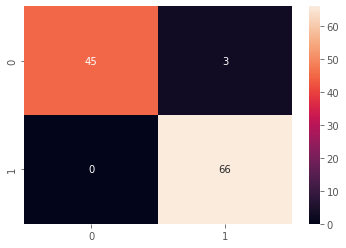

In [354]:
sns.heatmap(cn,  annot = True)

In [355]:
st=dt.now()
l_svc = SVC(kernel = 'linear')
l_svc.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

l_pred = l_svc.predict(x_test)

#Model Evaluation
lsvcacc = accuracy_score(y_test, l_pred)
print('Accuracy Score: ' + str(lsvcacc))

print('Precision Score: ' + str(precision_score(y_test, l_pred)))

print('Recall Score: ' + str(recall_score(y_test, l_pred)))

print('F1 Score: ' + str(f1_score(y_test, l_pred)))

print('Classification Report: \n' + str(classification_report(y_test, l_pred)))

Time taken to complete random search:  0:00:00.327386
Accuracy Score: 0.9736842105263158
Precision Score: 0.9701492537313433
Recall Score: 0.9848484848484849
F1 Score: 0.9774436090225564
Classification Report: 
              precision    recall  f1-score   support

         0.0       0.98      0.96      0.97        48
         1.0       0.97      0.98      0.98        66

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114



# CALCULATING F1 SCORE

In [356]:
from sklearn.metrics import f1_score
f1_score(y_test, yhat, average='weighted') 

0.9377278780169241

# CALCULATING JACCARD INDEX

In [357]:
from sklearn.metrics import jaccard_score
jaccard_score(y_test, yhat)

0.9041095890410958

In [358]:
param_grid ={'C':[0.1,1,10,100],'gamma':[1,0.1,0.01,0.001],'kernel':['rbf']}

In [359]:
from sklearn.model_selection import GridSearchCV

In [360]:
grid=GridSearchCV(SVC(),param_grid,refit=True,verbose=4)

In [363]:
grid.fit(x_train_scaled,y_train)

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV 1/5] END ........C=0.1, gamma=1, kernel=rbf;, score=1.000 total time=   0.0s
[CV 2/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.945 total time=   0.0s
[CV 3/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.912 total time=   0.0s
[CV 4/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.956 total time=   0.0s
[CV 5/5] END ........C=0.1, gamma=1, kernel=rbf;, score=0.934 total time=   0.0s
[CV 1/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.945 total time=   0.0s
[CV 2/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.901 total time=   0.0s
[CV 3/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.890 total time=   0.0s
[CV 4/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.923 total time=   0.0s
[CV 5/5] END ......C=0.1, gamma=0.1, kernel=rbf;, score=0.868 total time=   0.0s
[CV 1/5] END .....C=0.1, gamma=0.01, kernel=rbf;, score=0.648 total time=   0.0s
[CV 2/5] END .....C=0.1, gamma=0.01, kernel=rbf;

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100], 'gamma': [1, 0.1, 0.01, 0.001],
                         'kernel': ['rbf']},
             verbose=4)

In [364]:
grid.best_params_

{'C': 1, 'gamma': 1, 'kernel': 'rbf'}

In [365]:
grid_predictions=grid.predict(x_test_scaled)

In [366]:
cn =confusion_matrix(y_test,grid_predictions)

<AxesSubplot:>

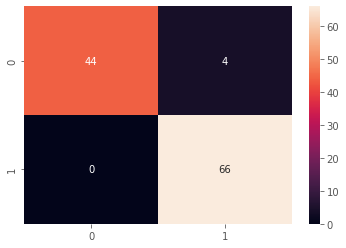

In [367]:
sns.heatmap(cn , annot =True)

In [368]:
print(classification_report(y_test,grid_predictions))

              precision    recall  f1-score   support

         0.0       1.00      0.92      0.96        48
         1.0       0.94      1.00      0.97        66

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



# DECISION TREE 

In [369]:
from sklearn.preprocessing import StandardScaler
sc= StandardScaler()
x_train_sc=sc.fit_transform(x_train)
x_test_sc=sc.transform(x_test)

In [370]:
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier

clf = DecisionTreeClassifier(criterion="entropy", max_depth=4)

# Train Decision Tree Classifer
clf = clf.fit(x_train,y_train)

#Predict the response for test dataset
y_pred_Df = clf.predict(x_test)


In [371]:
st=dt.now()
decison = DecisionTreeClassifier(criterion = 'entropy', 
                                 random_state = 0)
decison.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

decison_pred = decison.predict(x_test)

#Model Evaluation
dtacc = accuracy_score(y_test, decison_pred)
print('Accuracy Score: ' + str(dtacc))

print('Precision Score: ' + str(precision_score(y_test, decison_pred)))

print('Recall Score: ' + str(recall_score(y_test, decison_pred)))

print('F1 Score: ' + str(f1_score(y_test, decison_pred)))

print('Classification Report: \n' + str(classification_report(y_test, decison_pred)))

Time taken to complete random search:  0:00:00.008011
Accuracy Score: 0.9385964912280702
Precision Score: 0.9402985074626866
Recall Score: 0.9545454545454546
F1 Score: 0.9473684210526316
Classification Report: 
              precision    recall  f1-score   support

         0.0       0.94      0.92      0.93        48
         1.0       0.94      0.95      0.95        66

    accuracy                           0.94       114
   macro avg       0.94      0.94      0.94       114
weighted avg       0.94      0.94      0.94       114



# TRAINING THE MODEL USING SVM

# KERNEL SVM

In [372]:
st=dt.now()
gk_svc = SVC(kernel = 'rbf')
gk_svc.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

gk_pred = gk_svc.predict(x_test)

#Model Evaluation
ksvcaccacc = accuracy_score(y_test, gk_pred)
print('Accuracy Score: ' + str(ksvcaccacc))

print('Precision Score: ' + str(precision_score(y_test, gk_pred)))

print('Recall Score: ' + str(recall_score(y_test, gk_pred)))

print('F1 Score: ' + str(f1_score(y_test, gk_pred)))

print('Classification Report: \n' + str(classification_report(y_test, gk_pred)))

Time taken to complete random search:  0:00:00.008384
Accuracy Score: 0.9385964912280702
Precision Score: 0.9041095890410958
Recall Score: 1.0
F1 Score: 0.949640287769784
Classification Report: 
              precision    recall  f1-score   support

         0.0       1.00      0.85      0.92        48
         1.0       0.90      1.00      0.95        66

    accuracy                           0.94       114
   macro avg       0.95      0.93      0.94       114
weighted avg       0.94      0.94      0.94       114



# RANDOM FOREST CLASSIFIER

In [373]:
st=dt.now()
randomforest = RandomForestClassifier(n_estimators = 100, 
                                      random_state = 0)
randomforest.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

random_pred = randomforest.predict(x_test)

#Model Evaluation
rmacc = accuracy_score(y_test, random_pred)
print('Accuracy Score: ' + str(rmacc))

print('Precision Score: ' + str(precision_score(y_test, random_pred)))

print('Recall Score: ' + str(recall_score(y_test, random_pred)))

print('F1 Score: ' + str(f1_score(y_test, random_pred)))

print('Classification Report: \n' + str(classification_report(y_test, random_pred)))

Time taken to complete random search:  0:00:00.131093
Accuracy Score: 0.9649122807017544
Precision Score: 0.9558823529411765
Recall Score: 0.9848484848484849
F1 Score: 0.9701492537313432
Classification Report: 
              precision    recall  f1-score   support

         0.0       0.98      0.94      0.96        48
         1.0       0.96      0.98      0.97        66

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



# BERNOULLINB CLASSIFIER

In [374]:
st=dt.now()
bernb = BernoulliNB()
bernb.fit(x_train, y_train)
print("Time taken to complete random search: ",dt.now()-st)

bernb_predict = bernb.predict(x_test)

#Model Evaluation
bncacc = accuracy_score(y_test, bernb_predict)
print('Accuracy Score: ' + str(bncacc))

print('Precision Score: ' + str(precision_score(y_test, bernb_predict)))

print('Recall Score: ' + str(recall_score(y_test, bernb_predict)))

print('F1 Score: ' + str(f1_score(y_test, bernb_predict)))

print('Classification Report: \n' + str(classification_report(y_test, bernb_predict)))

Time taken to complete random search:  0:00:00
Accuracy Score: 0.5789473684210527
Precision Score: 0.5789473684210527
Recall Score: 1.0
F1 Score: 0.7333333333333334
Classification Report: 
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00        48
         1.0       0.58      1.00      0.73        66

    accuracy                           0.58       114
   macro avg       0.29      0.50      0.37       114
weighted avg       0.34      0.58      0.42       114



# MULTINOMIALNB CLASSIFIER

In [375]:
st=dt.now()
mulnb = MultinomialNB()
mulnb.fit(x_train, y_train) 
print("Time taken to complete random search: ",dt.now()-st)

mulnb_predict = mulnb.predict(x_test)

#Model Evaluation
mulacc = accuracy_score(y_test, mulnb_predict)
print('Accuracy Score: ' + str(mulacc))

print('Precision Score: ' + str(precision_score(y_test, mulnb_predict)))

print('Recall Score: ' + str(recall_score(y_test, mulnb_predict)))

print('F1 Score: ' + str(f1_score(y_test, mulnb_predict)))

print('Classification Report: \n' + str(classification_report(y_test, mulnb_predict)))

Time taken to complete random search:  0:00:00.000500
Accuracy Score: 0.9122807017543859
Precision Score: 0.868421052631579
Recall Score: 1.0
F1 Score: 0.9295774647887324
Classification Report: 
              precision    recall  f1-score   support

         0.0       1.00      0.79      0.88        48
         1.0       0.87      1.00      0.93        66

    accuracy                           0.91       114
   macro avg       0.93      0.90      0.91       114
weighted avg       0.92      0.91      0.91       114



# ARTIFICIAL NEURAL NETWORKS

In [376]:
#Building Our Model
# Initialising the ANN
classifier = Sequential()

#Input and 1st Hidden Layer
classifier.add(Dense(units = 20,
                     activation = 'relu',
                     kernel_initializer = 'uniform',
                     input_dim = 30))
classifier.add(keras.layers.Dropout(rate=0.2))


#2nd Hidden Layer
classifier.add(Dense(units = 20,
                     activation = 'relu',
                     kernel_initializer = 'uniform'))
classifier.add(keras.layers.Dropout(rate=0.2))

#3rd Hidden Layer
classifier.add(Dense(units = 20,
                     activation = 'relu',
                     kernel_initializer = 'uniform'))
classifier.add(keras.layers.Dropout(rate=0.2))            

#Output Layer
classifier.add(Dense(units = 1,
                     activation = 'sigmoid',
                     kernel_initializer = 'uniform'))
               
classifier.compile(optimizer = 'adam',
                   loss = 'binary_crossentropy',
                   metrics = ['accuracy']) 
classifier.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 20)                620       
_________________________________________________________________
dropout_12 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_17 (Dense)             (None, 20)                420       
_________________________________________________________________
dropout_13 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_18 (Dense)             (None, 20)                420       
_________________________________________________________________
dropout_14 (Dropout)         (None, 20)                0         
_________________________________________________________________
dense_19 (Dense)             (None, 1)                

In [377]:
#training our ANN Model
history = classifier.fit(x_train, 
                         y_train, 
                         batch_size = 16, 
                         epochs = 500, 
                         validation_split=0.15)

Epoch 1/500
25/25 [==============================] - 1s 10ms/step - loss: 0.6870 - accuracy: 0.6839 - val_loss: 0.6791 - val_accuracy: 0.8116
Epoch 2/500
25/25 [==============================] - 0s 3ms/step - loss: 0.6560 - accuracy: 0.7487 - val_loss: 0.6216 - val_accuracy: 0.8261
Epoch 3/500
25/25 [==============================] - 0s 3ms/step - loss: 0.5702 - accuracy: 0.7565 - val_loss: 0.5160 - val_accuracy: 0.8406
Epoch 4/500
25/25 [==============================] - 0s 3ms/step - loss: 0.4272 - accuracy: 0.8575 - val_loss: 0.4558 - val_accuracy: 0.7971
Epoch 5/500
25/25 [==============================] - 0s 2ms/step - loss: 0.3837 - accuracy: 0.8497 - val_loss: 0.4004 - val_accuracy: 0.8406
Epoch 6/500
25/25 [==============================] - 0s 4ms/step - loss: 0.3140 - accuracy: 0.8990 - val_loss: 0.3925 - val_accuracy: 0.8116
Epoch 7/500
25/25 [==============================] - 0s 2ms/step - loss: 0.2943 - accuracy: 0.8964 - val_loss: 0.4314 - val_accuracy: 0.8551
Epoch 8/500


Epoch 59/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1718 - accuracy: 0.9404 - val_loss: 0.4869 - val_accuracy: 0.8261
Epoch 60/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1940 - accuracy: 0.9119 - val_loss: 0.4367 - val_accuracy: 0.8406
Epoch 61/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1706 - accuracy: 0.9352 - val_loss: 0.3929 - val_accuracy: 0.8841
Epoch 62/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1975 - accuracy: 0.9326 - val_loss: 0.3497 - val_accuracy: 0.8406
Epoch 63/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1796 - accuracy: 0.9456 - val_loss: 0.4067 - val_accuracy: 0.8406
Epoch 64/500
25/25 [==============================] - 0s 2ms/step - loss: 0.2122 - accuracy: 0.9119 - val_loss: 0.4392 - val_accuracy: 0.8261
Epoch 65/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1892 - accuracy: 0.9326 - val_loss: 0.4197 - val_accuracy: 0.8261
Epoch 

25/25 [==============================] - 0s 3ms/step - loss: 0.1365 - accuracy: 0.9482 - val_loss: 0.4425 - val_accuracy: 0.8406
Epoch 174/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1394 - accuracy: 0.9430 - val_loss: 0.3277 - val_accuracy: 0.8986
Epoch 175/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1669 - accuracy: 0.9404 - val_loss: 0.3183 - val_accuracy: 0.8406
Epoch 176/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1584 - accuracy: 0.9352 - val_loss: 0.3857 - val_accuracy: 0.8261
Epoch 177/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1496 - accuracy: 0.9404 - val_loss: 0.5030 - val_accuracy: 0.8261
Epoch 178/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1534 - accuracy: 0.9378 - val_loss: 0.4061 - val_accuracy: 0.8261
Epoch 179/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1626 - accuracy: 0.9352 - val_loss: 0.2974 - val_accuracy: 0.8986
Epoch 180/500

25/25 [==============================] - 0s 2ms/step - loss: 0.1493 - accuracy: 0.9430 - val_loss: 0.3883 - val_accuracy: 0.8261
Epoch 288/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1398 - accuracy: 0.9456 - val_loss: 0.3726 - val_accuracy: 0.8261
Epoch 289/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1455 - accuracy: 0.9430 - val_loss: 0.3427 - val_accuracy: 0.8406
Epoch 290/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1172 - accuracy: 0.9560 - val_loss: 0.3457 - val_accuracy: 0.8406
Epoch 291/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1406 - accuracy: 0.9508 - val_loss: 0.2942 - val_accuracy: 0.8841
Epoch 292/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1304 - accuracy: 0.9430 - val_loss: 0.2999 - val_accuracy: 0.8261
Epoch 293/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1182 - accuracy: 0.9560 - val_loss: 0.2479 - val_accuracy: 0.8986
Epoch 294/500

25/25 [==============================] - 0s 2ms/step - loss: 0.1079 - accuracy: 0.9430 - val_loss: 0.2823 - val_accuracy: 0.8696
Epoch 402/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1418 - accuracy: 0.9275 - val_loss: 0.3205 - val_accuracy: 0.8841
Epoch 403/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1141 - accuracy: 0.9560 - val_loss: 0.4531 - val_accuracy: 0.8261
Epoch 404/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1335 - accuracy: 0.9534 - val_loss: 0.3026 - val_accuracy: 0.8841
Epoch 405/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1301 - accuracy: 0.9534 - val_loss: 0.2914 - val_accuracy: 0.8986
Epoch 406/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1185 - accuracy: 0.9456 - val_loss: 0.5862 - val_accuracy: 0.8406
Epoch 407/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1236 - accuracy: 0.9482 - val_loss: 0.6344 - val_accuracy: 0.8116
Epoch 408/500

25/25 [==============================] - 0s 2ms/step - loss: 0.1555 - accuracy: 0.9378 - val_loss: 0.2805 - val_accuracy: 0.8551
Epoch 459/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1512 - accuracy: 0.9275 - val_loss: 0.2905 - val_accuracy: 0.8841
Epoch 460/500
25/25 [==============================] - 0s 3ms/step - loss: 0.1151 - accuracy: 0.9456 - val_loss: 0.2982 - val_accuracy: 0.8841
Epoch 461/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1405 - accuracy: 0.9326 - val_loss: 0.4057 - val_accuracy: 0.8261
Epoch 462/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1343 - accuracy: 0.9430 - val_loss: 0.3796 - val_accuracy: 0.8261
Epoch 463/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1044 - accuracy: 0.9560 - val_loss: 0.3480 - val_accuracy: 0.8841
Epoch 464/500
25/25 [==============================] - 0s 2ms/step - loss: 0.1070 - accuracy: 0.9534 - val_loss: 0.2846 - val_accuracy: 0.9130
Epoch 465/500

In [378]:
# Part 3 - Making predictions and evaluating the model

# Predicting the Test set results
ann_pred = classifier.predict(x_test)
ann_pred = (ann_pred > 0.5)

#Model Evaluation
ann = accuracy_score(y_test, ann_pred)
print('Accuracy Score: ' + str(ann))

print('Precision Score: ' + str(precision_score(y_test, ann_pred)))

print('Recall Score: ' + str(recall_score(y_test, ann_pred)))

print('F1 Score: ' + str(f1_score(y_test, ann_pred)))

print('Classification Report: \n' + str(classification_report(y_test, ann_pred)))

Accuracy Score: 0.9473684210526315
Precision Score: 0.9166666666666666
Recall Score: 1.0
F1 Score: 0.9565217391304348
Classification Report: 
              precision    recall  f1-score   support

         0.0       1.00      0.88      0.93        48
         1.0       0.92      1.00      0.96        66

    accuracy                           0.95       114
   macro avg       0.96      0.94      0.94       114
weighted avg       0.95      0.95      0.95       114



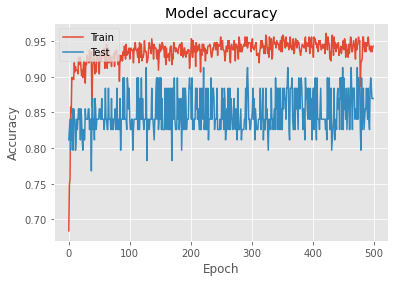

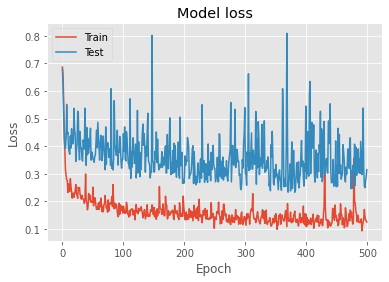

In [379]:
# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

# XGBOOST CLASSIFIER



In [386]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
import xgboost as xgb

In [387]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import NeighborhoodComponentsAnalysis
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=42)

# Dont fit the scaler while standardizate X_test !
scaler = StandardScaler()
x_train=scaler.fit_transform(x_train)
x_test=scaler.transform(x_test)
model.fit(x_train, y_train, eval_metric='mlogloss')
xgb.set_config(verbosity=0)

In [388]:
# Fitting XGBoost to the Training set
from xgboost import XGBClassifier
classifier = XGBClassifier()
classifier.fit(x_train, y_train)

pred_xgb = classifier.predict(x_test)

#Model Evaluation
xgb_acc = accuracy_score(y_test, pred_xgb)

print('Accuracy Score: ' + str(xgb_acc))

print('Precision Score: ' + str(precision_score(y_test, pred_xgb)))

print('Recall Score: ' + str(recall_score(y_test, pred_xgb)))

print('F1 Score: ' + str(f1_score(y_test, pred_xgb)))

print('Classification Report: \n' + str(classification_report(y_test, pred_xgb)))

Accuracy Score: 0.9824561403508771
Precision Score: 0.981651376146789
Recall Score: 0.9907407407407407
F1 Score: 0.9861751152073732
Classification Report: 
              precision    recall  f1-score   support

         0.0       0.98      0.97      0.98        63
         1.0       0.98      0.99      0.99       108

    accuracy                           0.98       171
   macro avg       0.98      0.98      0.98       171
weighted avg       0.98      0.98      0.98       171



In [389]:
print('\n                             Accuracy')
print('                            -------------')

print('Logistic Regression        : {:.04} %'.format(logits_acc * 100))
print('KNN Classifier             : {:.04} %'.format(kacc * 100))
print('Linear SVC                 : {:.04} %'.format(lsvcacc * 100))
print('Decision Trees Classifier  : {:.04} %'.format(dtacc * 100))
print('Gaussian Kernel SVC        : {:.04} %'.format(ksvcaccacc * 100))
print('Random Forest Classifier   : {:.04} %'.format(rmacc * 100))
print('BernoulliNB Classifier     : {:.04} %'.format(bncacc * 100))
print('MultinomialNB Classifier   : {:.04} %'.format(mulacc * 100))
print('Artificial Neural Network  : {:.04} %'.format(ann * 100))
print('XGB Classifier             : {:.04} %'.format(xgb_acc * 100))


                             Accuracy
                            -------------
Logistic Regression        : 95.61 %
KNN Classifier             : 95.61 %
Linear SVC                 : 97.37 %
Decision Trees Classifier  : 93.86 %
Gaussian Kernel SVC        : 93.86 %
Random Forest Classifier   : 96.49 %
BernoulliNB Classifier     : 57.89 %
MultinomialNB Classifier   : 91.23 %
Artificial Neural Network  : 94.74 %
XGB Classifier             : 98.25 %


Text(0.5, 1.0, 'Accuracy Comparism')

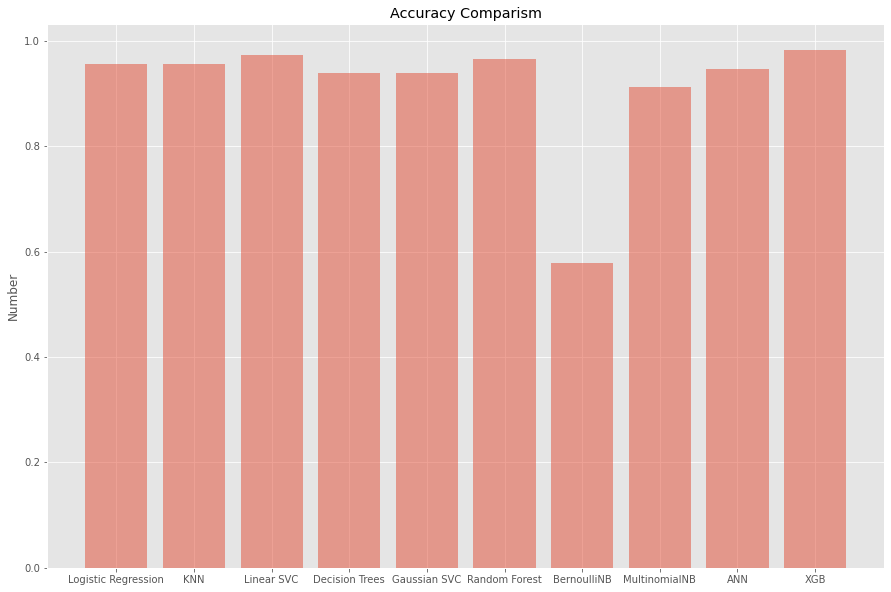

In [390]:
figure = plt.figure(figsize=(15, 10))
# Visualizing the results
objects = ['Logistic Regression',
           'KNN', 
           'Linear SVC',  
           'Decision Trees', 
           'Gaussian SVC',
           'Random Forest', 
           'BernoulliNB', 
           'MultinomialNB',
           'ANN',
           'XGB']
y_pos = np.arange(len(objects))
plt.bar(y_pos,[logits_acc,kacc,lsvcacc,dtacc,ksvcaccacc,rmacc,bncacc,mulacc, ann, xgb_acc],alpha=0.5)
plt.xticks(y_pos,objects)
plt.ylabel('Number')
plt.title('Accuracy Comparism')